## Import

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import GridSearchCV
from imblearn.under_sampling import RandomUnderSampler
from xgboost import XGBClassifier #pip install xgboost
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import roc_auc_score
from imblearn.pipeline import make_pipeline, Pipeline
from imblearn.over_sampling import SMOTE #pip install imbalanced-learn
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px
%matplotlib inline
import h5py
!pip install ivis[gpu]
from ivis import Ivis
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 647 kB 8.3 MB/s 
  Created wheel for annoy: filename=annoy-1.17.1-cp38-cp38-linux_x86_64.whl size=394079 sha256=15b9be2e54aadbb129709379d070d137d6d8902f3cb7b671988915c25f8de255
  Stored in directory: /root/.cache/pip/wheels/f9/93/19/30511c4a9ae6b4937455a134c34a39e13943e2c6f46fcd2ed2
Successfully built annoy


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
df_v2_new= pd.read_pickle('/content/drive/MyDrive/DataMining/file3.pkl')


In [ ]:
y =  df_v2_new['label']
del df_v2_new['label']

In [ ]:
over = SMOTE(sampling_strategy=0.015) #Increasing minority class to 15% of majority class
under = RandomUnderSampler(sampling_strategy=.50) # Decreasing majority class to 50% of minority class

steps = [('o', over), ('u', under)]
pipeline = Pipeline(steps=steps)

X_smote, y_smote = pipeline.fit_resample(df_v2_new, y)

In [ ]:
y_smote=y_smote.to_numpy()
X_smote=X_smote.to_numpy()

In [ ]:
train_X, test_X, train_Y, test_Y = train_test_split(X_smote, y_smote, stratify=y_smote,
                                                    test_size=0.2, random_state=1234)


In [ ]:
weight=.8
model = Ivis(embedding_dims=2, n_epochs_without_progress=5, supervision_weight=weight, model='szubert',k=15)

model.fit(train_X, train_Y)

Building KNN index


100%|██████████| 876856/876856 [00:06<00:00, 129549.28it/s]


Extracting KNN neighbours


100%|██████████| 876856/876856 [01:30<00:00, 9673.65it/s] 


Training neural network
Epoch 1/1000
6851/6851 [==============================] - 54s 8ms/step - loss: 0.2664 - stacked_triplets_loss: 0.1074 - supervised_loss: 0.3061
Epoch 2/1000
6851/6851 [==============================] - 53s 8ms/step - loss: 0.2283 - stacked_triplets_loss: 0.0728 - supervised_loss: 0.2671
Epoch 3/1000
6851/6851 [==============================] - 53s 8ms/step - loss: 0.2112 - stacked_triplets_loss: 0.0653 - supervised_loss: 0.2476
Epoch 4/1000
6851/6851 [==============================] - 52s 8ms/step - loss: 0.1952 - stacked_triplets_loss: 0.0603 - supervised_loss: 0.2289
Epoch 5/1000
6851/6851 [==============================] - 50s 7ms/step - loss: 0.1851 - stacked_triplets_loss: 0.0591 - supervised_loss: 0.2166
Epoch 6/1000
6851/6851 [==============================] - 49s 7ms/step - loss: 0.1765 - stacked_triplets_loss: 0.0583 - supervised_loss: 0.2060
Epoch 7/1000
6851/6851 [==============================] - 50s 7ms/step - loss: 0.1697 - stacked_triplets_loss: 0

Ivis(k=15, n_epochs_without_progress=5, supervision_weight=0.8)

In [ ]:


model.save_model('/content/drive/MyDrive/DataMining/model2f')

In [ ]:
train_embeddings = model.transform(train_X)
test_embeddings = model.transform(test_X)

1713/1713 [==============================] - 4s 2ms/step


Text(0.5, 1.0, 'Testing Set')

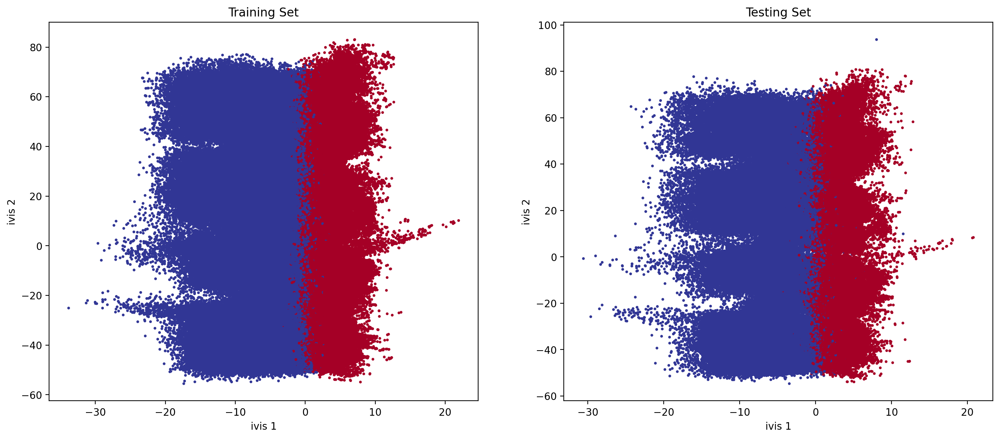

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(17, 7), dpi=200)
ax[0].scatter(x=train_embeddings[:, 0], y=train_embeddings[:, 1], c=train_Y, s=3, cmap='RdYlBu_r')
ax[0].set_xlabel('ivis 1')
ax[0].set_ylabel('ivis 2')
ax[0].set_title('Training Set')

ax[1].scatter(x=test_embeddings[:, 0], y=test_embeddings[:, 1], c=test_Y, s=3, cmap='RdYlBu_r')
ax[1].set_xlabel('ivis 1')
ax[1].set_ylabel('ivis 2')
ax[1].set_title('Testing Set')

In [ ]:
from sklearn.metrics import confusion_matrix, average_precision_score, roc_auc_score, classification_report
from sklearn.linear_model import LogisticRegression
clf = LogisticRegression(solver="lbfgs").fit(train_embeddings, train_Y)

In [ ]:
labels = clf.predict(test_embeddings)
proba = clf.predict_proba(test_embeddings)

In [ ]:
print(classification_report(test_Y, labels))

print('Confusion Matrix')
print(confusion_matrix(test_Y, labels))
print('Average Precision: '+str(average_precision_score(test_Y, proba[:, 1])))
print('ROC AUC: '+str(roc_auc_score(test_Y, labels)))

              precision    recall  f1-score   support

         0.0       0.98      0.98      0.98    146143
         1.0       0.96      0.97      0.96     73072

    accuracy                           0.98    219215
   macro avg       0.97      0.97      0.97    219215
weighted avg       0.98      0.98      0.98    219215

Confusion Matrix
[[143016   3127]
 [  2182  70890]]
Average Precision: 0.9932829659328795
ROC AUC: 0.9743710949582228


In [ ]:
weight=.8
model = Ivis(embedding_dims=3, n_epochs_without_progress=5, supervision_weight=weight, model='szubert',k=15)

model.fit(train_X, train_Y)

Building KNN index


100%|██████████| 876856/876856 [00:06<00:00, 126837.25it/s]


Extracting KNN neighbours


100%|██████████| 876856/876856 [01:27<00:00, 10015.31it/s]


Training neural network
Epoch 1/1000
6851/6851 [==============================] - 49s 7ms/step - loss: 0.2569 - stacked_triplets_loss: 0.0626 - supervised_loss: 0.3055
Epoch 2/1000
6851/6851 [==============================] - 50s 7ms/step - loss: 0.2197 - stacked_triplets_loss: 0.0403 - supervised_loss: 0.2646
Epoch 3/1000
6851/6851 [==============================] - 48s 7ms/step - loss: 0.2020 - stacked_triplets_loss: 0.0393 - supervised_loss: 0.2426
Epoch 4/1000
6851/6851 [==============================] - 48s 7ms/step - loss: 0.1872 - stacked_triplets_loss: 0.0385 - supervised_loss: 0.2244
Epoch 5/1000
6851/6851 [==============================] - 49s 7ms/step - loss: 0.1777 - stacked_triplets_loss: 0.0371 - supervised_loss: 0.2128
Epoch 6/1000
6851/6851 [==============================] - 48s 7ms/step - loss: 0.1699 - stacked_triplets_loss: 0.0359 - supervised_loss: 0.2034
Epoch 7/1000
6851/6851 [==============================] - 49s 7ms/step - loss: 0.1632 - stacked_triplets_loss: 0

Ivis(embedding_dims=3, k=15, n_epochs_without_progress=5,
     supervision_weight=0.8)

In [ ]:
model.save_model('/content/drive/MyDrive/DataMining/ivis-supervised-fraud3f')

In [ ]:
train_embeddings = model.transform(train_X)
test_embeddings = model.transform(test_X)

1713/1713 [==============================] - 4s 3ms/step


In [ ]:
df = pd.DataFrame(train_embeddings)
df["label"] = train_Y
df2 = pd.DataFrame(test_embeddings)
df2["label"] = test_Y


In [ ]:

labels = { 0: 'No Fraud', 1: 'Fraud'}
df["label"].replace(labels, inplace=True)
df2["label"].replace(labels, inplace=True)

In [ ]:
df=df.sample(200000)
df2=df2.sample(200000)

In [ ]:
import plotly.express as px

fig = px.scatter_3d( df, x=0, y=1, z=2,
              color='label', opacity=0.7)

# tight layout
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))


In [ ]:
fig = px.scatter_3d( df2, x=0, y=1, z=2,
              color='label', opacity=0.7)

# tight layout
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))

In [ ]:

clf = LogisticRegression(solver="lbfgs").fit(train_embeddings, train_Y)

In [ ]:
labels = clf.predict(test_embeddings)
proba = clf.predict_proba(test_embeddings)

In [ ]:
print(classification_report(test_Y, labels))

print('Confusion Matrix')
print(confusion_matrix(test_Y, labels))
print('Average Precision: '+str(average_precision_score(test_Y, proba[:, 1])))
print('ROC AUC: '+str(roc_auc_score(test_Y, labels)))

              precision    recall  f1-score   support

         0.0       0.98      0.98      0.98    146143
         1.0       0.96      0.97      0.96     73072

    accuracy                           0.98    219215
   macro avg       0.97      0.97      0.97    219215
weighted avg       0.98      0.98      0.98    219215

Confusion Matrix
[[143156   2987]
 [  2196  70876]]
Average Precision: 0.9937875997859161
ROC AUC: 0.9747542819449132


In [ ]:
weight=.8
model = Ivis(embedding_dims=7, n_epochs_without_progress=5, supervision_weight=weight, model='szubert',k=15)

model.fit(train_X, train_Y)

Building KNN index


100%|██████████| 876856/876856 [00:06<00:00, 130943.65it/s]


Extracting KNN neighbours


100%|██████████| 876856/876856 [01:37<00:00, 8966.78it/s]


Training neural network
Epoch 1/1000
6851/6851 [==============================] - 56s 8ms/step - loss: 0.2498 - stacked_triplets_loss: 0.0386 - supervised_loss: 0.3026
Epoch 2/1000
6851/6851 [==============================] - 55s 8ms/step - loss: 0.2099 - stacked_triplets_loss: 0.0175 - supervised_loss: 0.2580
Epoch 3/1000
6851/6851 [==============================] - 55s 8ms/step - loss: 0.1930 - stacked_triplets_loss: 0.0175 - supervised_loss: 0.2369
Epoch 4/1000
6851/6851 [==============================] - 54s 8ms/step - loss: 0.1786 - stacked_triplets_loss: 0.0169 - supervised_loss: 0.2191
Epoch 5/1000
6851/6851 [==============================] - 54s 8ms/step - loss: 0.1687 - stacked_triplets_loss: 0.0174 - supervised_loss: 0.2066
Epoch 6/1000
6851/6851 [==============================] - 55s 8ms/step - loss: 0.1607 - stacked_triplets_loss: 0.0172 - supervised_loss: 0.1965
Epoch 7/1000
6851/6851 [==============================] - 55s 8ms/step - loss: 0.1541 - stacked_triplets_loss: 0

Ivis(embedding_dims=7, k=15, n_epochs_without_progress=5,
     supervision_weight=0.8)

In [ ]:
model.save_model('/content/drive/MyDrive/DataMining/model7f')

In [ ]:
weight=.8
model = Ivis(embedding_dims=7, n_epochs_without_progress=5, supervision_weight=weight, model='szubert',k=15)
model.load_model('/content/drive/MyDrive/DataMining/model7f')

Ivis(callbacks=[], embedding_dims=7, k=15, n_epochs_without_progress=5,
     supervision_weight=0.8)

In [ ]:
df_v2_new= pd.read_pickle('/content/drive/MyDrive/DataMining/file3.pkl')

In [ ]:
y =  df_v2_new['label']
del df_v2_new['label']
y=y.to_numpy()
x_x=df_v2_new.to_numpy()

In [ ]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
train_embeddings = model.transform(x_x)
df = pd.DataFrame(train_embeddings)
minmax_scaler = MinMaxScaler().fit(df)
df = minmax_scaler.transform(df)
df = pd.DataFrame(df)
df["label"] = y

df.head()

190523/190523 [==============================] - 282s 1ms/step


,0,1,2,3,4,5,6,label
0,0.755608,0.485490,0.495076,0.629360,0.469401,0.611696,0.739901,0.0
1,0.668953,0.537702,0.480973,0.670242,0.366366,0.416830,0.726169,0.0
2,0.651498,0.521750,0.506433,0.701506,0.413261,0.613676,0.782894,0.0
3,0.758055,0.478949,0.504500,0.619930,0.477581,0.611527,0.748637,0.0
4,0.755918,0.494885,0.381224,0.568077,0.504888,0.427512,0.509551,0.0


In [ ]:

from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import GridSearchCV
from imblearn.under_sampling import RandomUnderSampler
from xgboost import XGBClassifier #pip install xgboost
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import roc_auc_score
from imblearn.pipeline import make_pipeline, Pipeline
from imblearn.over_sampling import SMOTE #pip install imbalanced-learn
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px
from collections import Counter
%matplotlib inline
import numpy as np

In [ ]:
X, y = df.drop("label", axis=1), df["label"]

## SAMPLING 1 - Random Under Sampling

In [ ]:

counter = Counter(y)
print(counter)
rus = RandomUnderSampler(random_state=42)
X_rand_resampled, y_rand_resampled = rus.fit_resample(X, y)
counter = Counter(y_rand_resampled)
print(counter)

Counter({0.0: 24357143, 1.0: 29757})
Counter({0.0: 29757, 1.0: 29757})


In [ ]:
from sklearn.model_selection import ShuffleSplit
models = [{'name': 'xgb','label': 'XGBoost',
           'classifier': XGBClassifier(objective="binary:logistic", eval_metric="auc", use_label_encoder=False),
           'grid': {"gamma":[0.5, 1, 1.5, 2, 5],
           "max_depth":[3,4,5,6],
           "min_child_weight": [100],
           "subsample": [0.6, 0.8, 1.0],
           "colsample_bytree": [0.6, 0.8, 1.0],
           "learning_rate": [0.1, 0.01, 0.001],
           "scale_pos_weight":[5,10,17]}},
           
           {'name': 'rf', 'label': 'Random Forest',
           'classifier': RandomForestClassifier(random_state=88),
           'grid': {'n_estimators': [200, 500],'max_features': ['auto', 'sqrt', 'log2'],
                    'max_depth' : [4,5,6,7,8],'criterion' :['gini', 'entropy']}},
           
           {'name': 'dsc','label': 'Descision Tree', 
           'classifier': DecisionTreeClassifier(random_state=88),
           'grid': {"max_depth":np.arange(8)+1}},
          
           {'name': 'knn','label':'K Nearest Neighbors',
           'classifier':KNeighborsClassifier(),
           'grid': {"n_neighbors":np.arange(8)+1}},
            
            {'name': 'bbn','label': 'Bayesian Classifiers', 
           'classifier': GaussianNB(),
           'grid': {'var_smoothing': np.logspace(0,-9, num=100)}}]
          
           #{'name': 'svm_rbf', 'label': 'SVC (RBF)',
           #'classifier':SVC(random_state=88),
           #'grid': {'C': [1, 10, 100, 1000], 'gamma': [0.001, 0.0001], 'kernel': ['rbf']}

            
def model_selection(classifier, name, grid, X, y, scoring):
    
    gridsearch_cv=GridSearchCV(classifier, 
                               grid,
                               cv=ShuffleSplit(test_size=0.20, n_splits=1, random_state=88),n_jobs=-1, 
                               scoring = scoring)
    
    gridsearch_cv.fit(X, y)
    results_dict = {}
    results_dict['classifier_name'] = name    
    results_dict['classifier'] = gridsearch_cv.best_estimator_
    results_dict['best_params'] = gridsearch_cv.best_params_
    results_dict['ROC_AUC'] = gridsearch_cv.best_score_
    return(results_dict)



In [ ]:
results = []
for m in models:    
    print(m['name'])    
    results.append(model_selection(m['classifier'], 
                                   m['name'],
                                   m['grid'],
                                   X_rand_resampled, 
                                   y_rand_resampled, 
                                   'roc_auc'))      
    print('completed')
            
            
results_df = pd.DataFrame(results).sort_values(by='ROC_AUC', ascending = False)

xgb
completed
rf
completed
dsc
completed
knn
completed
bbn
completed


In [ ]:
results_df.to_csv('/content/drive/MyDrive/DataMining/randomsam', encoding='utf-8', index=False)

In [ ]:

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    stratify=y, 
                                                    test_size=0.25)

In [ ]:
# SAMPLING 1 - RANDOM UNDER SAMPLING
counter = Counter(y_train)
print(counter)
rus = RandomUnderSampler(random_state=42)
X_rand_resampled, y_rand_resampled = rus.fit_resample(X_train, y_train)
counter = Counter(y_rand_resampled)
print(counter)

Counter({0.0: 18267857, 1.0: 22318})
Counter({0.0: 22318, 1.0: 22318})


In [ ]:
np.random.seed(42)
from sklearn.model_selection import train_test_split
import xgboost as xgb
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import roc_auc_score
from imblearn.over_sampling import SMOTE
from collections import Counter
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score,precision_score, recall_score, f1_score, roc_auc_score

In [ ]:
#XGB classifier

clf_XGB = xgb.XGBClassifier(colsample_bytree=1.0, 
                            eval_metric='auc', 
                            gamma=5, 
                            max_depth=4,
                            min_child_weight=100,
                            use_label_encoder=False, 
                            learning_rate = 0.1,
                            scale_pos_weight = 10)

clf_XGB.fit(X_rand_resampled, y_rand_resampled)
ypreds_XGB=clf_XGB.predict(X_test)


#Random Forest Classifier

clf_RF = RandomForestClassifier(criterion='entropy', 
                                max_depth=8, 
                                max_features='auto',
                                n_estimators=200)
clf_RF.fit(X_rand_resampled, y_rand_resampled)
ypreds_RF=clf_RF.predict(X_test)

#Decision Tree Classifier

clf_DT = DecisionTreeClassifier(max_depth=4)
clf_DT.fit(X_rand_resampled, y_rand_resampled)
ypreds_DT=clf_DT.predict(X_test)

#Bayesian Classifier

clf_BY = GaussianNB(var_smoothing=8.111308307896872e-07)
clf_BY.fit(X_rand_resampled, y_rand_resampled)
ypreds_BY=clf_BY.predict(X_test)

#KNN

clf_KNN = KNeighborsClassifier(n_neighbors=8)
clf_KNN.fit(X_rand_resampled, y_rand_resampled)
ypreds_KNN=clf_BY.predict(X_test)

#Printing Comparsion of all 3 algorithms

Comparison_df = pd.DataFrame({'Algorithm': ["XGB", "RF", "DT","BAY", "KNN"],
                         'Accuracy': [accuracy_score(y_test, ypreds_XGB), accuracy_score(y_test, ypreds_RF),
                                        accuracy_score(y_test, ypreds_DT), accuracy_score(y_test, ypreds_BY), accuracy_score(y_test, ypreds_KNN)],
                         'Precision': [precision_score(y_test, ypreds_XGB), precision_score(y_test, ypreds_RF),
                                        precision_score(y_test, ypreds_DT), precision_score(y_test, ypreds_BY), precision_score(y_test, ypreds_KNN)],
                         'Recall': [recall_score(y_test, ypreds_XGB), recall_score(y_test, ypreds_RF),
                                        recall_score(y_test, ypreds_DT),recall_score(y_test, ypreds_BY),recall_score(y_test, ypreds_KNN)],
                         'F1-score': [f1_score(y_test, ypreds_XGB, average='micro'), f1_score(y_test, ypreds_RF, average='micro'), f1_score(y_test, ypreds_DT, average='micro'),
                                      f1_score(y_test, ypreds_BY, average='micro'),f1_score(y_test, ypreds_KNN, average='micro')],
                         'ROC-AUC': [roc_auc_score(y_test, ypreds_XGB),roc_auc_score(y_test, ypreds_RF),roc_auc_score(y_test, ypreds_DT),
                                     roc_auc_score(y_test, ypreds_BY), roc_auc_score(y_test, ypreds_KNN)]})
Comparison_df.set_index("Algorithm", inplace=True)
print(Comparison_df)

           Accuracy  Precision    Recall  F1-score   ROC-AUC
Algorithm                                                   
XGB        0.934667   0.018272  0.996505  0.934667  0.965548
RF         0.970408   0.038997  0.983466  0.970408  0.976929
DT         0.970561   0.039152  0.982390  0.970561  0.976468
BAY        0.952196   0.024335  0.976610  0.952196  0.964388
KNN        0.952196   0.024335  0.976610  0.952196  0.964388


## SAMPLING 2 - Random 2.5M sample

In [ ]:
# Combine x_reduced and y into a new dataframe df_transformed and pass it here
df_transformed_sample = pd.DataFrame(X_train)
df_transformed_sample["label"] = y_train
df_transformed_sample = df_transformed_sample.sample(2500000) #more than 10%
X_100k, y_100k = df_transformed_sample.drop("label", axis=1), df_transformed_sample[["label"]].values.flatten()
counter = Counter(y_100k)
print (counter)

Counter({0.0: 2497022, 1.0: 2978})


In [ ]:
#XGB classifier

clf_XGB = xgb.XGBClassifier(colsample_bytree=1.0, 
                            eval_metric='auc', 
                            gamma=5, 
                            max_depth=4,
                            min_child_weight=100,
                            use_label_encoder=False, 
                            learning_rate = 0.1,
                            scale_pos_weight = 10)

clf_XGB.fit(X_100k, y_100k)
ypreds_XGB=clf_XGB.predict(X_test)


#Random Forest Classifier

clf_RF = RandomForestClassifier(criterion='entropy', 
                                max_depth=8, 
                                max_features='auto',
                                n_estimators=200)
clf_RF.fit(X_100k, y_100k)
ypreds_RF=clf_RF.predict(X_test)

#Decision Tree Classifier

clf_DT = DecisionTreeClassifier(max_depth=4)
clf_DT.fit(X_100k, y_100k)
ypreds_DT=clf_DT.predict(X_test)

#Bayesian Classifier

clf_BY = GaussianNB(var_smoothing=8.111308307896872e-07)
clf_BY.fit(X_100k, y_100k)
ypreds_BY=clf_BY.predict(X_test)

#KNN

clf_KNN = KNeighborsClassifier(n_neighbors=8)
clf_KNN.fit(X_100k, y_100k)
ypreds_KNN=clf_BY.predict(X_test)

#Printing Comparsion of all 3 algorithms

Comparison_df = pd.DataFrame({'Algorithm': ["XGB", "RF", "DT","BAY", "KNN"],
                         'Accuracy': [accuracy_score(y_test, ypreds_XGB), accuracy_score(y_test, ypreds_RF),
                                        accuracy_score(y_test, ypreds_DT), accuracy_score(y_test, ypreds_BY), accuracy_score(y_test, ypreds_KNN)],
                         'Precision': [precision_score(y_test, ypreds_XGB), precision_score(y_test, ypreds_RF),
                                        precision_score(y_test, ypreds_DT), precision_score(y_test, ypreds_BY), precision_score(y_test, ypreds_KNN)],
                         'Recall': [recall_score(y_test, ypreds_XGB), recall_score(y_test, ypreds_RF),
                                        recall_score(y_test, ypreds_DT),recall_score(y_test, ypreds_BY),recall_score(y_test, ypreds_KNN)],
                         'F1-score': [f1_score(y_test, ypreds_XGB, average='micro'), f1_score(y_test, ypreds_RF, average='micro'), f1_score(y_test, ypreds_DT, average='micro'),
                                      f1_score(y_test, ypreds_BY, average='micro'),f1_score(y_test, ypreds_KNN, average='micro')],
                         'ROC-AUC': [roc_auc_score(y_test, ypreds_XGB),roc_auc_score(y_test, ypreds_RF),roc_auc_score(y_test, ypreds_DT),
                                     roc_auc_score(y_test, ypreds_BY), roc_auc_score(y_test, ypreds_KNN)]})
Comparison_df.set_index("Algorithm", inplace=True)
print(Comparison_df)

           Accuracy  Precision    Recall  F1-score   ROC-AUC
Algorithm                                                   
XGB        0.998273   0.385061  0.696465  0.998273  0.847553
RF         0.999148   0.882935  0.347762  0.999148  0.673853
DT         0.999157   0.813884  0.400323  0.999157  0.700105
BAY        0.999050   0.699636  0.387955  0.999050  0.693876
KNN        0.999050   0.699636  0.387955  0.999050  0.693876


## SAMPLING 3 - SMOTE - Combining over and undersampling


In [ ]:
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline

over = SMOTE(sampling_strategy=0.012) #Increasing minority class to 1% of majority class
under = RandomUnderSampler(sampling_strategy=0.5) # Decreasing majority class to 50% of minority class

steps = [('o', over), ('u', under)]
pipeline = Pipeline(steps=steps)

X_smote, y_smote = pipeline.fit_resample(X_train, y_train)
counter = Counter(y_smote)
print (counter)

Counter({0.0: 438428, 1.0: 219214})


In [ ]:
#XGB classifier

clf_XGB = xgb.XGBClassifier(colsample_bytree=1.0, 
                            eval_metric='auc', 
                            gamma=5, 
                            max_depth=4,
                            min_child_weight=100,
                            use_label_encoder=False, 
                            learning_rate = 0.1,
                            scale_pos_weight = 10)

clf_XGB.fit(X_smote, y_smote)
ypreds_XGB=clf_XGB.predict(X_test)


#Random Forest Classifier

clf_RF = RandomForestClassifier(criterion='entropy', 
                                max_depth=8, 
                                max_features='auto',
                                n_estimators=200)
clf_RF.fit(X_smote, y_smote)
ypreds_RF=clf_RF.predict(X_test)

#Decision Tree Classifier

clf_DT = DecisionTreeClassifier(max_depth=4)
clf_DT.fit(X_smote, y_smote)
ypreds_DT=clf_DT.predict(X_test)

#Bayesian Classifier

clf_BY = GaussianNB(var_smoothing=8.111308307896872e-07)
clf_BY.fit(X_smote, y_smote)
ypreds_BY=clf_BY.predict(X_test)

#KNN

clf_KNN = KNeighborsClassifier(n_neighbors=8)
clf_KNN.fit(X_smote, y_smote)
ypreds_KNN=clf_BY.predict(X_test)

#Printing Comparsion of all 3 algorithms

Comparison_df = pd.DataFrame({'Algorithm': ["XGB", "RF", "DT","BAY", "KNN"],
                         'Accuracy': [accuracy_score(y_test, ypreds_XGB), accuracy_score(y_test, ypreds_RF),
                                        accuracy_score(y_test, ypreds_DT), accuracy_score(y_test, ypreds_BY), accuracy_score(y_test, ypreds_KNN)],
                         'Precision': [precision_score(y_test, ypreds_XGB), precision_score(y_test, ypreds_RF),
                                        precision_score(y_test, ypreds_DT), precision_score(y_test, ypreds_BY), precision_score(y_test, ypreds_KNN)],
                         'Recall': [recall_score(y_test, ypreds_XGB), recall_score(y_test, ypreds_RF),
                                        recall_score(y_test, ypreds_DT),recall_score(y_test, ypreds_BY),recall_score(y_test, ypreds_KNN)],
                         'F1-score': [f1_score(y_test, ypreds_XGB, average='micro'), f1_score(y_test, ypreds_RF, average='micro'), f1_score(y_test, ypreds_DT, average='micro'),
                                      f1_score(y_test, ypreds_BY, average='micro'),f1_score(y_test, ypreds_KNN, average='micro')],
                         'ROC-AUC': [roc_auc_score(y_test, ypreds_XGB),roc_auc_score(y_test, ypreds_RF),roc_auc_score(y_test, ypreds_DT),
                                     roc_auc_score(y_test, ypreds_BY), roc_auc_score(y_test, ypreds_KNN)]})
Comparison_df.set_index("Algorithm", inplace=True)
print(Comparison_df)

           Accuracy  Precision    Recall  F1-score   ROC-AUC
Algorithm                                                   
XGB        0.959504   0.028982  0.990321  0.959504  0.974894
RF         0.977170   0.049438  0.971636  0.977170  0.974406
DT         0.980920   0.058086  0.961957  0.980920  0.971450
BAY        0.966933   0.034236  0.959269  0.966933  0.963105
KNN        0.966933   0.034236  0.959269  0.966933  0.963105
